# Explore Data

* In this notebook we explore the data to identify required data transformation, for ML training
* Before data transformation, we'll split the train/test data to avoid any data snooping.

## Import Libraries

In [87]:
## import the necessary libraries
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
# from plotly.offline import init_notebook_mode
# import plotly.io as pio
# init_notebook_mode(connected=False)
# pio.renderers.default = 'notebook'
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.impute import 
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, StandardScaler
from sklearn.metrics.pairwise import rbf_kernel


## Load the data

In [88]:
## constants
raw_data_path = Path("..", "data", "raw", "housing")
processed_data_path = Path("..", "data", "processed", "housing")
report_images_path = Path("..", "reports", "figures")

## create processed data directory if it does not exist
processed_data_path.mkdir(parents=True, exist_ok=True)

In [89]:
## read the data
data = pd.read_csv(Path(raw_data_path, "data.csv"));

## Data Exploration

In [90]:
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [91]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [92]:
data.size

206400

In [93]:
data["ocean_proximity"].value_counts()

ocean_proximity
<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: count, dtype: int64

In [94]:
data.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


Observations:

* The mean for following columns is a lot larger than the median, which indicates that there are some outliers in the data.
    * `total_rooms`
    * `total_bedrooms`
    * `population`
    * `households`
    * `median_income`
    * `median_house_value`

## Data Visualization

### Histograms & Box Plots

#### Helper Functions

In [95]:
## helper functions to plot histogram and save image in reports directory
def plot_histogram(data, column):
    fig = px.histogram(data, x=column, title=f"{column} Histogram")
    fig.show()
    fig.write_image(Path(report_images_path, f"{column}_hitogram.webp"))
    
    
## helper function to plot box plot and save image to reports directory
def plot_box(data, column):
    fig = px.box(data, y=column, title=f"{column} Box Plot")
    fig.show()
    fig.write_image(Path(report_images_path, f"{column}_box_plot.webp"))

In [96]:
## create histograms for all columns using plotly
## read column names
column_names = data.columns

## create histograms for all columns
for column in column_names:
    plot_histogram(data, column)
    plot_box(data,column)

Observations:
* The `median_house_age` and `median_house_value` are capped at 52 and 500001 respectively. Which means our ML model may not be able to predict house values beyond these values.
    * To fix this we might need to remove the districts with capped values.

### Measuring Kurtosis

- **Types of Kurtosis:**
    - **Leptokurtic (Kurtosis > 3):** Heavy tails; more extreme values.
    - **Mesokurtic (Kurtosis ≈ 3):** Similar to normal distribution.
    - **Platykurtic (Kurtosis < 3):** Short tails; fewer extreme values.
- **Interpretation:**
    - **High Kurtosis:** Data has heavy tails and possibly a sharp peak.
    - **Low Kurtosis:** Data has light tails and a flatter peak.

In [97]:
data.select_dtypes(include=[np.number]).kurtosis()

longitude             -1.330152
latitude              -1.117760
housing_median_age    -0.800629
total_rooms           32.630927
total_bedrooms        21.985575
population            73.553116
households            22.057988
median_income          4.952524
median_house_value     0.327870
dtype: float64

### Measuring Skewness
Interpreting Skewness Values:

* Skewness ≈ 0: Distribution is symmetric.
* Skewness > 0: Distribution is positively skewed (right-skewed).
* Skewness < 0: Distribution is negatively skewed (left-skewed).

In [98]:
data.select_dtypes(include=[np.number]).skew()

longitude            -0.297801
latitude              0.465953
housing_median_age    0.060331
total_rooms           4.147343
total_bedrooms        3.459546
population            4.935858
households            3.410438
median_income         1.646657
median_house_value    0.977763
dtype: float64

Observations:
* `median_house_age` have multiple peaks, we can try and create new features with similarity
* Following features are heavy tailed on the right, which means we'll need to transform it, to make the distribution more symmetrical
    * total_rooms           33.209115
    * total_bedrooms        21.349133
    * population            20.238864
    * households            20.896291
    * median_income          4.783031

## Creating a Test Set

* To avoid sampling bais we need to be careful while creating the test set. 
* Instead of random sampling we can use stratified sampling to create a test set that is representative of the overall population.
* We need to understand the data and create strata based on the most important features.
    * I think `median_income` and `ocean_proximity` are the most important features in this dataset which might effect the `median_house_value`.

* Lets check how random sampling and stratified sampling differ in terms of the distribution of the data.

### Creating Bins for `median_income`

In [99]:
"""
Categorizes the 'median_income' column into discrete income categories.

This code creates a new column 'income_categories' in the DataFrame 'data' by 
binning the values in the 'median_income' column into specified ranges. The 
ranges are defined by the 'bins' parameter, and each bin is assigned a label 
from 1 to 5.

Parameters:
    data (pd.DataFrame): The DataFrame containing the 'median_income' column.

Returns:
    None: The function modifies the DataFrame in place by adding the 
    'income_categories' column.

Example:
    data["income_categories"] = pd.cut(data["median_income"], 
                                       bins=[0., 1.5, 3.0, 4.5, 6., np.inf], 
                                       labels=[1, 2, 3, 4, 5])
"""
data["income_categories"] = pd.cut(data["median_income"], bins=[
                                   0., 1.5, 3.0, 4.5, 6., np.inf], labels=[1, 2, 3, 4, 5])

In [100]:
data["income_categories"].value_counts()/data.shape[0] * 100

income_categories
3    35.058140
2    31.884690
4    17.630814
5    11.443798
1     3.982558
Name: count, dtype: float64

### Creating `Bins` for `Population`

In [101]:
data["population_categories"] = pd.cut(data["population"], bins=10, labels=[
                                   1, 2, 3, 4, 5, 6, 7, 8,9,10])

In [102]:
data["population_categories"].value_counts()/data.shape[0] * 100

population_categories
1     96.007752
2      3.444767
3      0.460271
4      0.058140
5      0.019380
9      0.004845
10     0.004845
6      0.000000
7      0.000000
8      0.000000
Name: count, dtype: float64

In [103]:
data[data["population_categories"] == 1]["population"].describe()

count    19816.000000
mean      1266.191865
std        697.487838
min          3.000000
25%        773.000000
50%       1136.000000
75%       1636.000000
max       3570.000000
Name: population, dtype: float64

In [104]:
data["population"].describe()

count    20640.000000
mean      1425.476744
std       1132.462122
min          3.000000
25%        787.000000
50%       1166.000000
75%       1725.000000
max      35682.000000
Name: population, dtype: float64

In [105]:
train_set, test_set = train_test_split(data, test_size=0.2, random_state=42)

In [106]:
train_set.shape

(16512, 12)

In [107]:
test_set.shape

(4128, 12)

### Comparing Random Sampling and Stratified Sampling

#### Comparing Ocean Proximity Distribution

In [108]:
## print ocean proximity percent
train_set["ocean_proximity"].value_counts()/train_set.shape[0] * 100

ocean_proximity
<1H OCEAN     44.289002
INLAND        31.952519
NEAR OCEAN    12.663517
NEAR BAY      11.064680
ISLAND         0.030281
Name: count, dtype: float64

In [109]:
test_set["ocean_proximity"].value_counts()/test_set.shape[0] * 100

ocean_proximity
<1H OCEAN     44.161822
INLAND        30.886628
NEAR OCEAN    13.735465
NEAR BAY      11.216085
Name: count, dtype: float64

#### Comparing Income Categories Distribution

In [110]:
train_set["income_categories"].value_counts()/train_set.shape[0] * 100

income_categories
3    35.192587
2    32.170543
4    17.435804
5    11.282703
1     3.918362
Name: count, dtype: float64

In [111]:
test_set["income_categories"].value_counts()/test_set.shape[0] * 100

income_categories
3    34.520349
2    30.741279
4    18.410853
5    12.088178
1     4.239341
Name: count, dtype: float64

#### Comparing Population Categories Distribution

In [112]:
train_set["population_categories"].value_counts()/train_set.shape[0] * 100

population_categories
1     95.960514
2      3.488372
3      0.466328
4      0.066618
5      0.006056
9      0.006056
10     0.006056
6      0.000000
7      0.000000
8      0.000000
Name: count, dtype: float64

In [113]:
test_set["population_categories"].value_counts()/test_set.shape[0] * 100

population_categories
1     96.196705
2      3.270349
3      0.436047
5      0.072674
4      0.024225
6      0.000000
7      0.000000
8      0.000000
9      0.000000
10     0.000000
Name: count, dtype: float64

Observations:
* The distribution of the data is similar in both random and stratified sampling. I wonder why?
* Just to be safe, I will use stratified sampling to create the test set and then compare the difference. 

### Creating Stratified Split

In [114]:
splitter = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)

In [115]:
for train_idx, test_idx in splitter.split(data, data["income_categories"]):
    strata_train_set = data.iloc[train_idx]
    strata_test_set = data.iloc[test_idx]    

In [116]:
strata_train_set.shape

(16512, 12)

#### Comparing Income Categories

In [117]:
strata_train_set["income_categories"].value_counts()/strata_train_set.shape[0] * 100

income_categories
3    35.059351
2    31.885901
4    17.629603
5    11.446221
1     3.978924
Name: count, dtype: float64

In [118]:
strata_test_set.shape

(4128, 12)

In [119]:
strata_test_set["income_categories"].value_counts()/strata_test_set.shape[0] * 100

income_categories
3    35.053295
2    31.879845
4    17.635659
5    11.434109
1     3.997093
Name: count, dtype: float64

Observations:
* The income categories are distributed more accurately in stratified sampling compared to random sampling. So we'll use stratified sampling to create the test set.

### Write To File

In [120]:
strata_train_set.to_csv(Path(processed_data_path,"train_set.csv"))
strata_test_set.to_csv(Path(processed_data_path,"test_set.csv"))

## Exploratory Data Analysis

In [121]:
trainset_copy = strata_train_set.copy()

In [122]:
trainset_copy.shape

(16512, 12)

EDA steps:
* Visualize the data
* Look for correlations
    * Feature engineering and feature selection

Opens:
* If ocean proximity has a strong correlation with median house value, we might need to convert it to a numerical value.
* Age and Location (lat, long) might be related to house value too will need to figure out a way to handle that. 

### Visualizing Lat, Long Data

* Lets try and visualize lat,long using plotly.

In [123]:
trainset_copy.loc[:,["latitude","longitude","median_house_value", "population"]].head()

,latitude,longitude,median_house_value,population
13096,37.80,-122.42,458300.0,1576.0
14973,34.14,-118.38,483800.0,666.0
3785,38.36,-121.98,101700.0,562.0
14689,33.75,-117.11,96100.0,1845.0
20507,33.77,-118.15,361800.0,1912.0


In [124]:
fig = px.scatter_geo(trainset_copy.loc[:,["latitude","longitude","median_house_value"]], lat="latitude", lon="longitude", color="median_house_value", title="Median House Value vs Location", labels={"median_house_value": "Median House Value"})
# fig.update_layout()
fig.update_geos(fitbounds="locations")
fig.show()
fig.write_image(Path(report_images_path, f"geo_mapping.webp"))

Observations:
* As imagined most of high value houses are near SF, LA, Sacremento
* Also seems like houses closer to ocean are expensive than further away. 
* Finally it seems that population density has some affect on house price too, higher population more the median house price. 
    * I wonder if we had additional data, like education, crime etc how would this look, I think there might be some connection between those. 

* Just out of curiosity I want to see how income categories are distributed across the map.

In [125]:
fig = px.scatter_geo(trainset_copy.loc[:,["latitude","longitude","income_categories"]], lat="latitude", lon="longitude", color="income_categories",
                     title="Income Categories vs Location", labels={"income_categories": "Income Categories"}, category_orders={"income_categories": [1, 2, 3, 4, 5]},)
# fig.update_layout()
fig.update_geos(fitbounds="locations")
fig.show()
fig.write_image(Path(report_images_path, f"income_categories_mapping.webp"))

Observations:
* Interesting to note that highest income categories are centered around Silicon Valley and LA.

In [126]:
fig = px.scatter_geo(trainset_copy.loc[:,["latitude","longitude","population"]], lat="latitude", lon="longitude", color="population",
                     title="Population vs Location", scope="usa")
# fig.update_layout()
fig.update_geos(fitbounds="locations")
fig.show()
fig.write_image(Path(report_images_path, f"population_mapping.webp"))

* I wonder if population bins would represent any additional info, we know 96% of districts have population below 4000. 
* We'll pin it for now and explore it later.

### Correlations

In [127]:
corr_matrix = trainset_copy.corr(numeric_only=True)

In [128]:
corr_matrix["median_house_value"].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.688380
total_rooms           0.137455
housing_median_age    0.102175
households            0.071426
total_bedrooms        0.054635
population           -0.020153
longitude            -0.050859
latitude             -0.139584
Name: median_house_value, dtype: float64

### Feature Engineering Attributes

In [129]:
trainset_copy["rooms_per_house"] = trainset_copy["total_rooms"] / trainset_copy["households"]
trainset_copy["bedrooms_ratio"] = trainset_copy["total_bedrooms"] / trainset_copy["total_rooms"]
trainset_copy["people_per_house"] = trainset_copy["population"] / trainset_copy["households"]

In [130]:
corr_matrix = trainset_copy.corr(numeric_only=True)

In [131]:
corr_matrix["median_house_value"].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.688380
rooms_per_house       0.143663
total_rooms           0.137455
housing_median_age    0.102175
households            0.071426
total_bedrooms        0.054635
population           -0.020153
people_per_house     -0.038224
longitude            -0.050859
latitude             -0.139584
bedrooms_ratio       -0.256397
Name: median_house_value, dtype: float64

Observations:
* I am not sure why `bedrooms_ratio` is negatively correlated to `median_house_value`. My intuition was that if number of bedrooms are more then the house value should increase. 
    * Lets plot the data to get better understanding

In [132]:
fig = px.scatter(trainset_copy, x="bedrooms_ratio", y="median_house_value")
fig.show()

In [133]:
fig = px.scatter(trainset_copy, x="rooms_per_house", y="median_house_value")
fig.show()

Observations:
* I might have overestimated the correlation strength based on the values. On research I got to learn that 0.25 is generally considered a weak correlation. Which is obvious from the plot. 

## Explore Data Preparation for ML Algorithms

### Separate features and target varialbe

In [134]:
df_features = strata_train_set.drop("median_house_value", axis=1)
df_labels = strata_train_set["median_house_value"].copy()

### Data Cleaning

In [135]:
df_features.isna().sum()

longitude                  0
latitude                   0
housing_median_age         0
total_rooms                0
total_bedrooms           168
population                 0
households                 0
median_income              0
ocean_proximity            0
income_categories          0
population_categories      0
dtype: int64

In [136]:
df_features[df_features.isna()]["total_bedrooms"]

13096   NaN
14973   NaN
3785    NaN
14689   NaN
20507   NaN
         ..
14207   NaN
13105   NaN
19301   NaN
19121   NaN
19888   NaN
Name: total_bedrooms, Length: 16512, dtype: float64

In [137]:
## Finding the percent of missing values
(df_features.isna().sum() / df_features.shape[0])*100

longitude                0.000000
latitude                 0.000000
housing_median_age       0.000000
total_rooms              0.000000
total_bedrooms           1.017442
population               0.000000
households               0.000000
median_income            0.000000
ocean_proximity          0.000000
income_categories        0.000000
population_categories    0.000000
dtype: float64

Observations:
* Only one feature `total_bedrooms` have 168 rows with missing data, which is around 1% of train set. Not bad, we can probably impute it with median without any side effects

In [138]:
df_features["total_bedrooms"].describe()

count    16344.000000
mean       538.949094
std        423.862079
min          1.000000
25%        296.000000
50%        434.000000
75%        645.000000
max       6210.000000
Name: total_bedrooms, dtype: float64

Observations:
* We can either drop the column, or drop the rows with missing values of fill in missing values with mean or median.
* `total_bedrooms` does have outliers and is a bit right skewed. So may be filling in with median will counter the skewness.
* We will use `SimpleImputer` for this, although this might be an overkill for just one column, it will be a good learning experience, plus we can try different imputer strategies later to understand the difference

In [139]:
imputer = SimpleImputer(strategy="median")

In [140]:
## select only the numeric datatypes
df_features_num = df_features.select_dtypes(include=[np.number])

In [141]:
df_features_num.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income'],
      dtype='object')

In [142]:
# fit the data
imputer.fit(df_features_num)

SimpleImputer(strategy='median')

In [143]:
# check the imputer statistics
imputer.statistics_

array([-118.51  ,   34.26  ,   29.    , 2125.    ,  434.    , 1167.    ,
        408.    ,    3.5385])

Observations:
* These numbers represent the `median` values for each of the columns in `data_num`
* We can convert it into a df for prettier representation and understanding

In [144]:
pd.DataFrame([imputer.statistics_], columns=imputer.get_feature_names_out())

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
0,-118.51,34.26,29.0,2125.0,434.0,1167.0,408.0,3.5385


In [145]:
# transform the training set
# transform will impute the missing data with median
df_features_num_imputed = pd.DataFrame(imputer.transform(df_features_num), columns=df_features_num.columns,index=df_features_num.index)

In [146]:
df_features_num_imputed.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
13096,-122.42,37.80,52.0,3321.0,1115.0,1576.0,1034.0,2.0987
14973,-118.38,34.14,40.0,1965.0,354.0,666.0,357.0,6.0876
3785,-121.98,38.36,33.0,1083.0,217.0,562.0,203.0,2.4330
14689,-117.11,33.75,17.0,4174.0,851.0,1845.0,780.0,2.2618
20507,-118.15,33.77,36.0,4366.0,1211.0,1912.0,1172.0,3.5292


In [147]:
df_features_num_imputed.shape

(16512, 8)

In [148]:
df_features_num_imputed.isna().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
dtype: int64

### Dropping Outliers

In [149]:
from sklearn.ensemble import IsolationForest

isolation_forest = IsolationForest(random_state=42)
outlier_pred = isolation_forest.fit_predict(df_features_num_imputed)

In [150]:
len(outlier_pred)

16512

In [151]:
outlier_pred

array([-1,  1,  1, ...,  1,  1,  1])

Observation:
* So the `fit_predict` method returned an array of size of the training data with 1's for `inliers` and -1 for `outlier` records. 
* We can now use this array to remove the outliers

In [152]:
df_features_num_imputed.iloc[outlier_pred == -1].shape

(2064, 8)

Observation:
* So we have 2000 outliers, I wonder if we can check which features were used for the outliers
* But I don't have any insight on which features contribute to these outliers. From what I've learnt so far, `IsolationForest` identifies outliers at the row level and not feature level. 
* Trying to find the features, could be a whole different exploration task, so for now, I'll just add the outlier column to the dataset. And remove the outliers before ML training. 
* We can revisit this step again if needed. 

TODO:
* Use different outlier detection methods that help identifying columns contributing to outlier, making it easy to decide whether we wan't to remove them or not. 

In [153]:
## removing the outliers
df_features_num_imputed = df_features_num_imputed.iloc[outlier_pred == 1]
df_features_cat = df_features.iloc[outlier_pred == 1] # this is for the categorical data
df_labels = df_labels.iloc[outlier_pred == 1]

In [154]:
print(df_features_num_imputed.shape)
print(df_features_cat.shape)
print(df_labels.shape)

(14448, 8)
(14448, 11)
(14448,)


### Handling Text & Categorial Attributes

In [156]:
df_features_cat = df_features_cat[["ocean_proximity"]]
df_features_cat.head()

,ocean_proximity
14973,<1H OCEAN
3785,INLAND
14689,INLAND
20507,NEAR OCEAN
1286,INLAND


Observations:
* We have couple of options to handle the categorical data. Either use `OrdinalEncoder` to create single column with multiple numerical values for each categories.  Or use `OneHotEncoding` and create multiple columns. 
* The potential issue with `OrdinalEncoder` would be that different categorical values might seem related during ML training. But that is not necessarily the case. We might end up capturing the wrong degree of similarity between each category. So for now we'll just use `OneHotEncoding`

In [157]:
encoder = OneHotEncoder(sparse_output=False)
df_features_cat_encoded = encoder.fit_transform(df_features_cat)

In [158]:
df_features_cat_encoded

array([[1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       ...,
       [0., 0., 0., 0., 1.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1.]])

In [159]:
## converting it into a DataFrame
pd.DataFrame(df_features_cat_encoded,columns=encoder.get_feature_names_out(),index=df_features_cat.index)

,ocean_proximity_<1H OCEAN,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN
14973,1.0,0.0,0.0,0.0,0.0
3785,0.0,1.0,0.0,0.0,0.0
14689,0.0,1.0,0.0,0.0,0.0
20507,0.0,0.0,0.0,0.0,1.0
1286,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...
14207,1.0,0.0,0.0,0.0,0.0
13105,0.0,1.0,0.0,0.0,0.0
19301,0.0,0.0,0.0,0.0,1.0
19121,1.0,0.0,0.0,0.0,0.0


Observations:
* I think we got lucky that we had all 5 categories in the training set. That might not always be the case. I think the right approach to do this could be, either before splitting the training set or creating a strata based on categories too. 

### Feature Transformation

* Since the following features are positive and heavy right tailed we need to transform it using `logarithm` to shrink the tail,
    * `total_rooms`
    * `total_bedrooms`
    * `population`
    * `households`
    * `median_income`

In [161]:
# Lets compare the before after histograms for all of the above colums
columns_to_transform = ["total_rooms", "total_bedrooms",
                        "population", "households", "median_income"]

# data_log_transformed = data.copy()
# for feature in columns_to_transform:
#     data_log_transformed[feature] = np.log1p(data_log_transformed[feature])

for column in columns_to_transform:
    fig = px.histogram(df_features_num_imputed, x=column, title=f"{column} before log transformation")
    fig.show()
    df_features_num_imputed[column] = df_features_num_imputed[column].apply(np.log1p)
    fig = px.histogram(df_features_num_imputed, x=column, title=f"{column} after log transformation")
    fig.show()

### Feature Scaling

In [162]:
std_scaler = StandardScaler()


In [164]:

df_features_num_scaled = std_scaler.fit_transform(df_features_num_imputed.select_dtypes(include=[np.number]))

In [165]:
pd.DataFrame(df_features_num_scaled, columns=std_scaler.get_feature_names_out())

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
0,0.595527,-0.692801,0.875904,-0.007866,-0.276208,-0.908619,-0.137202,1.345572
1,-1.273032,1.361924,0.292345,-1.098831,-1.208505,-1.219838,-1.205454,-0.815390
2,1.254713,-0.882693,-1.041504,1.372212,1.397619,0.960392,1.344417,-0.967884
3,0.714907,-0.872955,0.542442,1.454605,2.071458,1.025848,2.116991,0.010676
4,-0.925272,1.167164,1.876291,-0.139229,-0.585348,-0.833120,-0.350338,-0.111996
...,...,...,...,...,...,...,...,...
14443,0.585146,-0.829134,0.959270,0.229592,0.720807,-0.280664,0.586394,0.701556
14444,0.112816,0.368645,-0.541311,0.733282,0.704754,0.478694,0.618741,-0.695986
14445,1.280665,-1.447499,-1.374966,1.257190,1.218981,1.735071,1.295143,0.341977
14446,0.585146,-0.731753,0.625807,1.191049,1.446362,0.836987,1.480482,0.390984


In [166]:
for column in columns_to_transform:
    fig = px.histogram(pd.DataFrame(df_features_num_scaled, columns=std_scaler.get_feature_names_out()), x=column, title=f"{column} before log transformation")
    fig.show()

### Handling Multi Modal Distribution

* We have a multi modal feature `housing_median_age`, i.e it has multiple modes or peaks. We've decided to create a new feature called similarity measure for each of the modes. 
* The only thing to think about and consider is whether to perform multi modal analysis before or after scaling. 
* After researching a big it seems we can do it before scaling and take advantage of similarity calculation on original values.  This is because the scale of the values is not too big. 
* We'll use `GaussianMixture` and/or `GaussianKDE` to find number of modes and their values and create features for each mode. 
* Right now even though we've scalled before this analysis, in the transformer pipeline, we'll make sure we'll scale after this analysis. 

In [175]:
## using df_features_num_imputed to explore housing_median_age since we need the data unscaled
df_features_num_imputed["housing_median_age"].describe()

count    14448.000000
mean        29.493217
std         11.995775
min          1.000000
25%         20.000000
50%         30.000000
75%         37.000000
max         52.000000
Name: housing_median_age, dtype: float64

#### Finding Number of Modes using GaussianMixture

Optimal number of components: 8


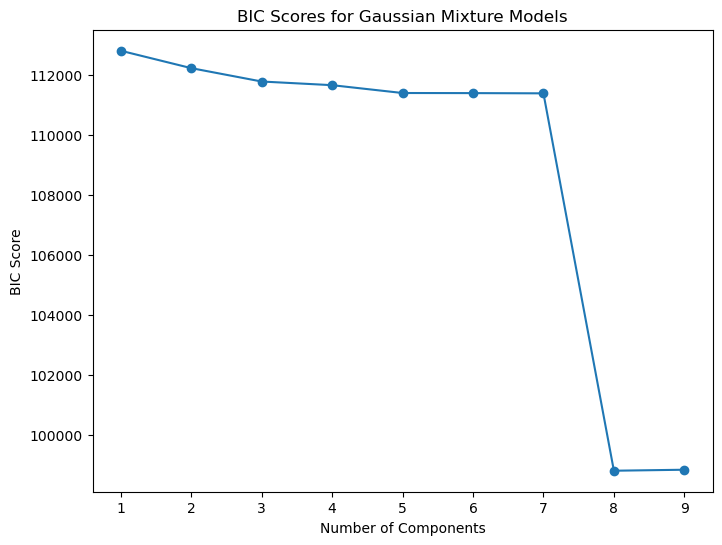

In [176]:
from sklearn.mixture import GaussianMixture
import numpy as np

# Prepare data
X = df_features_num_imputed["housing_median_age"].values.reshape(-1, 1)

# Try different numbers of components
n_components = np.arange(1, 10)
models = [GaussianMixture(n, covariance_type='full', random_state=0).fit(X) for n in n_components]

# Compute BIC scores
bics = [m.bic(X) for m in models]

# Find the number of components with the lowest BIC
optimal_n = n_components[np.argmin(bics)]
print(f"Optimal number of components: {optimal_n}")

# Plot BIC scores
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.plot(n_components, bics, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('BIC Score')
plt.title('BIC Scores for Gaussian Mixture Models')
plt.show()


#### Finding Number of Modes using Gaussian KDE

Number of peaks detected: 4
Peaks Are: [16.82582583 26.01501502 34.94894895 51.64264264]


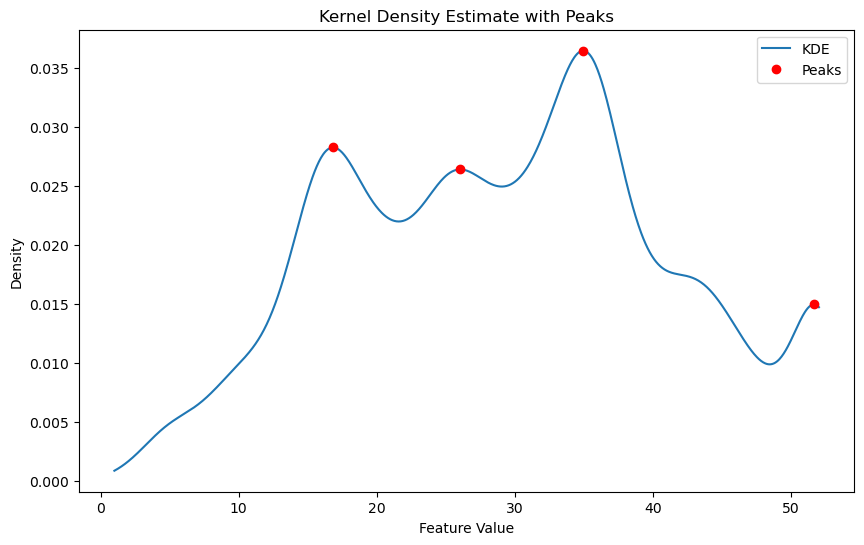

In [177]:
import numpy as np
import pandas as pd
from scipy.signal import find_peaks
from scipy.stats import gaussian_kde
import matplotlib.pyplot as plt

feature_data = df_features_num_imputed["housing_median_age"].dropna()

# Perform KDE
kde = gaussian_kde(feature_data)
x_grid = np.linspace(feature_data.min(), feature_data.max(), 1000)
kde_values = kde.evaluate(x_grid)

# Find peaks in KDE
peaks, _ = find_peaks(kde_values)

# Number of peaks
num_peaks = len(peaks)
print(f"Number of peaks detected: {num_peaks}")
print(f"Peaks Are: {x_grid[peaks]}")

# Plot
plt.figure(figsize=(10, 6))
plt.plot(x_grid, kde_values, label='KDE')
plt.plot(x_grid[peaks], kde_values[peaks], 'ro', label='Peaks')
plt.title('Kernel Density Estimate with Peaks')
plt.xlabel('Feature Value')
plt.ylabel('Density')
plt.legend()
plt.show()


* Lets create new features dynamically from the 4 peaks that we got via `KDE` method

In [179]:
feature_data = df_features_num_imputed["housing_median_age"].values.reshape(-1, 1)

for peak in x_grid[peaks]:
    feature_name = f"age_simil_{int(peak)}"
    df_features_num_imputed[feature_name] = rbf_kernel(feature_data, [[peak]], gamma=0.1)
    print(f'int value of peak is {feature_name}')

int value of peak is age_simil_16
int value of peak is age_simil_26
int value of peak is age_simil_34
int value of peak is age_simil_51


In [180]:
df_features_num_imputed.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,age_simil_16,age_simil_26,age_simil_34,age_simil_51
14973,-118.38,34.14,40.0,7.583756,5.872118,6.502790,5.880533,1.958347,4.748398e-24,3.206838e-09,7.797932e-02,1.297446e-06
3785,-121.98,38.36,33.0,6.988413,5.384495,6.333280,5.318120,1.233435,4.351976e-12,7.604603e-03,6.839707e-01,8.057062e-16
14689,-117.11,33.75,17.0,8.336870,6.747587,7.520776,6.660575,1.182279,9.969709e-01,2.954386e-04,1.019910e-14,7.581727e-53
20507,-118.15,33.77,36.0,8.381832,7.100027,7.556428,7.067320,1.510545,1.079465e-16,4.678291e-05,8.954124e-01,2.361292e-11
1286,-121.31,37.96,52.0,7.512071,5.710427,6.543912,5.768321,1.469394,1.853994e-54,4.737968e-30,2.362622e-13,9.873108e-01


* After creating this features ideally we want to scale the data.

In [182]:
df_features_num_scaled = std_scaler.fit_transform(df_features_num_imputed.select_dtypes(include=[np.number]))

In [184]:
pd.DataFrame(df_features_num_scaled, columns=std_scaler.get_feature_names_out())

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,age_simil_16,age_simil_26,age_simil_34,age_simil_51
0,0.595527,-0.692801,0.875904,-0.007866,-0.276208,-0.908619,-0.137202,1.345572,-0.490417,-0.494889,-0.342009,-0.294346
1,-1.273032,1.361924,0.292345,-1.098831,-1.208505,-1.219838,-1.205454,-0.815390,-0.490417,-0.468837,1.471831,-0.294351
2,1.254713,-0.882693,-1.041504,1.372212,1.397619,0.960392,1.344417,-0.967884,2.783167,-0.493877,-0.575414,-0.294351
3,0.714907,-0.872955,0.542442,1.454605,2.071458,1.025848,2.116991,0.010676,-0.490417,-0.494729,2.104713,-0.294351
4,-0.925272,1.167164,1.876291,-0.139229,-0.585348,-0.833120,-0.350338,-0.111996,-0.490417,-0.494889,-0.575414,3.763800
...,...,...,...,...,...,...,...,...,...,...,...,...
14443,0.585146,-0.829134,0.959270,0.229592,0.720807,-0.280664,0.586394,0.701556,-0.490417,-0.494889,-0.498510,-0.294302
14444,0.112816,0.368645,-0.541311,0.733282,0.704754,0.478694,0.618741,-0.695986,-0.417841,0.885406,-0.575413,-0.294351
14445,1.280665,-1.447499,-1.374966,1.257190,1.218981,1.735071,1.295143,0.341977,0.269326,-0.494889,-0.575414,-0.294351
14446,0.585146,-0.731753,0.625807,1.191049,1.446362,0.836987,1.480482,0.390984,-0.490417,-0.494869,1.389904,-0.294351


## Explore Target Data

* Lets explore the target data to see if it needs any kind of transformation

In [185]:
df_labels.describe()

count     14448.000000
mean     203819.500484
std      111468.781574
min       14999.000000
25%      120400.000000
50%      178500.000000
75%      259200.000000
max      500001.000000
Name: median_house_value, dtype: float64

Observations:
* So `mean` is greater than the median, which indicates the data is right skewed. 

In [187]:
for column in df_labels.to_frame().columns:
    plot_histogram(df_labels, column)
    plot_box(df_labels, column)

In [188]:
df_labels.to_frame().select_dtypes(include=[np.number]).kurtosis()

median_house_value    0.480516
dtype: float64

In [189]:
df_labels.to_frame().select_dtypes(include=[np.number]).skew()

median_house_value    1.003305
dtype: float64

Observation:
* It seems the data is not heavy tailed but it is skewed to the right. 
* Am not sure if we need to transform it before training, will need to look into it. 

## Conclusion

After exploring the data I think we need the following data transformations (in same order)
* Fill in missing values
* Convert `ocean_proximity` to one hot encoding
* Feature Engineering `rooms_per_house`, `bedroom_ratio` and `people_per_house`
* Add cluster similarity features
* Drop Outliers
* Transform heavy tailed features using logarithm
* Scale all numeric features. 